In [9]:
%pip install vk vk_api pandas 
import vk_api, vk 

access_token = 'vk1.a.CTmqRZCcbnfqpuaBwpSFfhG2rnnpQaAhCbm1g1ClqHuaK9DD3Zk7uN9krNitarY1HNoMTt_JLBOGVze16iuJvautzk038_0eMGUBRqrOYLOf9YLuuft0flueoUzlpibIaPxH1MDXbgWHFK4uWpFcXsyNhrWUUGDApU3BcT'
app_id = 51750797
my_id = 359004643

session = vk_api.VkApi(token=access_token)
vk = session.get_api()
users = vk.users.get(user_id=my_id, fields = 'id, first_name, city, universities, country, about')
users

Defaulting to user installation because normal site-packages is not writeable

[notice] A new release of pip available: 22.3.1 -> 23.2.1
[notice] To update, run: python -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


[{'id': 359004643,
  'about': '',
  'universities': [],
  'first_name': 'Ваня',
  'last_name': 'Фадеев',
  'can_access_closed': True,
  'is_closed': False}]

In [5]:
import pandas as pd

df = pd.DataFrame([users[0]])
df

,id,about,universities,first_name,last_name,can_access_closed,is_closed
0,359004643,,[],Ваня,Фадеев,True,False


Task 2: Граф друзей

In [16]:
%pip install requests numpy networkx matplotlib scipy pandas
import requests
import numpy as np
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt


Defaulting to user installation because normal site-packages is not writeable

[notice] A new release of pip available: 22.3.1 -> 23.2.1
[notice] To update, run: python -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [7]:
CENTRAL_USER_ID = my_id

def get_friends(token, user_id, with_name = False):
    fields = 'first_name,last_name,city' if with_name else ''
    url = 'https://api.vk.com/method/friends.get?' + \
                        'access_token={}&user_id={}&fields={}&v=5.81'.format(token,user_id, fields)
    response = requests.get(url).json()
    if response.get('error'):
        return []
    return response['response']['items']

friends_list = get_friends(access_token, CENTRAL_USER_ID, True)
friends = {friend['id']: friend['first_name'] + " " + friend['last_name'] for friend in friends_list}
friends[my_id] = users[0]['first_name'] + " " + users[0]['last_name']
friends

{2731347: 'Максим Коваль',
 7274642: 'Борис Никоноров',
 9394704: 'Надежда Самарченко',
 11656360: 'Любовь Сергеева',
 15366195: 'Vlad Nasibari',
 19530967: 'Александр Матвеев',
 21828903: 'Mikhail Sovetlyanov',
 33165886: 'Дмитрий Тимофеев',
 44561704: 'Александр Паршин',
 49820693: 'Анастасия Матвеева',
 54054837: 'No Name',
 59399858: 'Виктор Колпаков',
 75601001: 'Артем Дрянигин',
 84911208: 'Александр Чернявский',
 125367804: 'Роман Ильичев',
 135786920: 'Варя Буланова',
 143581002: 'Антон Бахтин',
 144037170: 'Анастасия Новикова',
 144935983: 'Матвей Колпаков',
 145138894: 'Abu Khalimov',
 150810764: 'Алёна Тарасова',
 154205777: 'Варвара Николина',
 161340147: 'Денис Животов',
 161659734: 'Айхан Мамедов',
 164975099: 'Ислам Закиров',
 166879324: 'Илья Бокарев',
 169986143: 'Роман Якимов',
 172722203: 'Елизавета Вишневская',
 178345551: 'Лёша Буров',
 179963970: 'Наталья Агапова',
 184178737: 'Narek Muradyan',
 186546001: 'Алёна Клюкина',
 189674146: 'Андрей Грудинин',
 189730112

In [8]:
import time
import random
graph = {}

for user_id in friends.keys():
    graph[user_id] = get_friends(access_token, user_id)
    time.sleep(0.1)


In [9]:

g = nx.Graph()
for user_id, user_friends in graph.items():
    g.add_node(friends[user_id])
    for friends_id in user_friends:
        if friends_id in friends.keys():
            g.add_edge(friends[user_id], friends[friends_id])


In [10]:
def graph_plot():
    plt.figure(figsize=(12, 9))
    nx.draw_kamada_kawai(g, with_labels=False, node_size=50, width=0.5)
    plt.show()


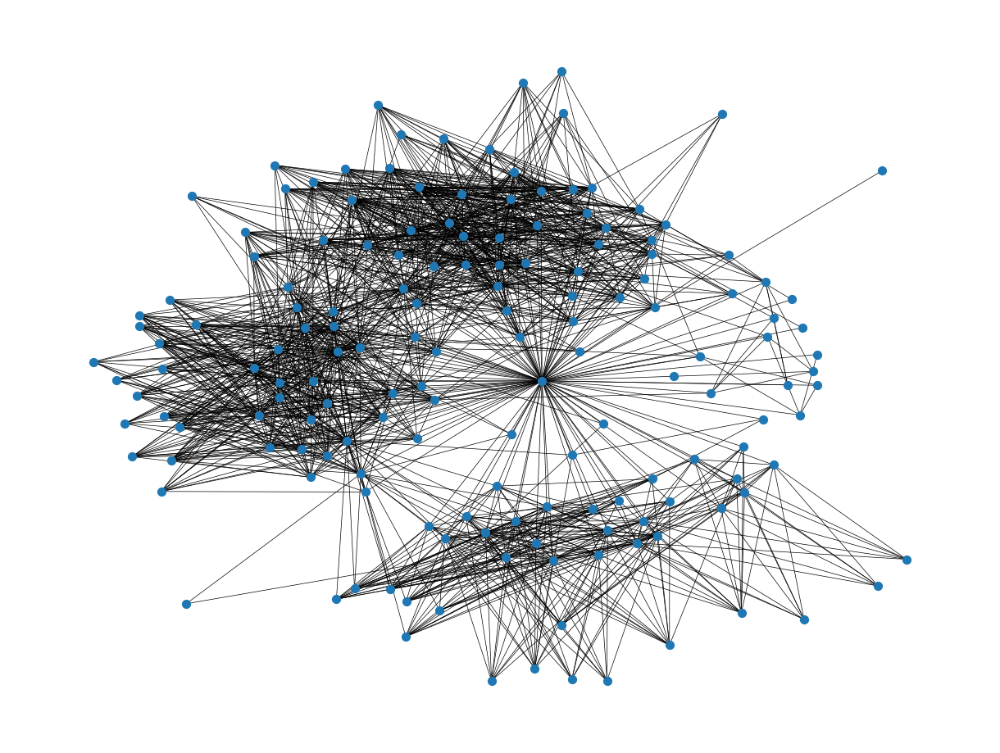

In [11]:
graph_plot()

In [12]:
def graph_plot2():
    plt.figure(figsize=(12, 9))
    nx.draw_kamada_kawai(g, with_labels=True, node_size=50, width=0.5)
    plt.show()

/home/maj0rio/.local/lib/python3.11/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 3256 (\N{KANNADA LETTER SA}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/maj0rio/.local/lib/python3.11/site-packages/IPython/core/pylabtools.py:152: UserWarning: Matplotlib currently does not support Kannada natively.
  fig.canvas.print_figure(bytes_io, **kw)
/home/maj0rio/.local/lib/python3.11/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 3248 (\N{KANNADA LETTER RA}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/maj0rio/.local/lib/python3.11/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 3235 (\N{KANNADA LETTER NNA}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/maj0rio/.local/lib/python3.11/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 3263 (\N{KANNADA VOWEL SIGN I}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/m

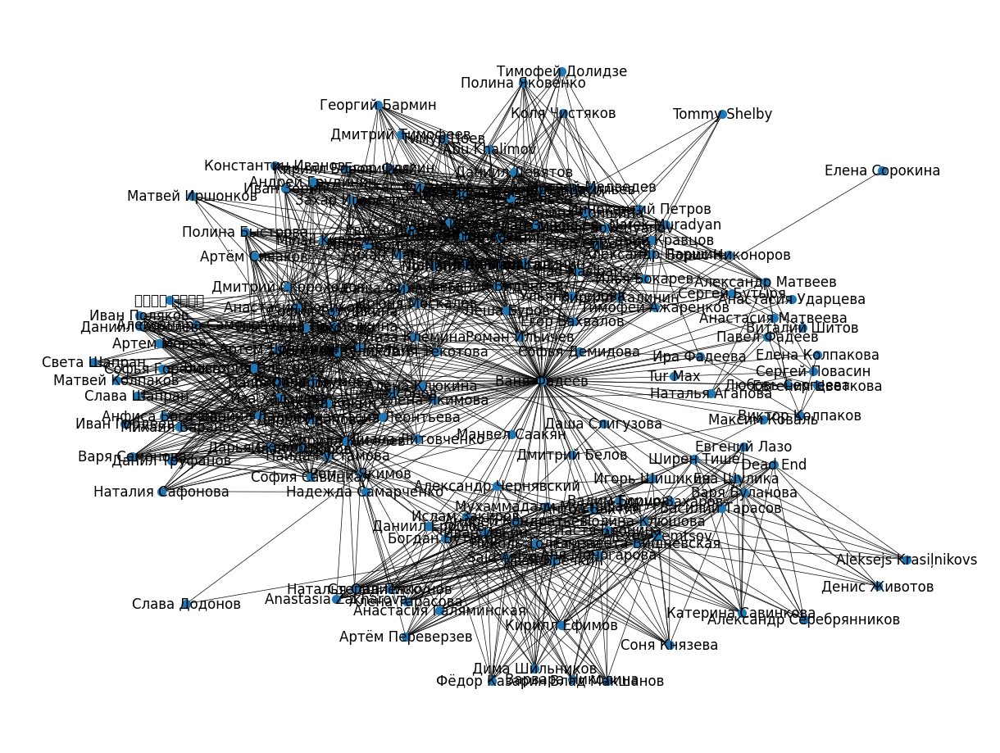

In [13]:
graph_plot2()

In [14]:

g.remove_node(friends[CENTRAL_USER_ID])
def graph_plot_save(name):
    plt.figure(figsize=(120, 90))
    nx.draw_kamada_kawai(g, with_labels=True, node_size=50, width=0.5)
    plt.savefig(name)

In [15]:
graph_plot_save('my_friends2.png')

/tmp/ipykernel_3960/3650444195.py:5: UserWarning: Glyph 3256 (\N{KANNADA LETTER SA}) missing from current font.
  plt.savefig(name)
/tmp/ipykernel_3960/3650444195.py:5: UserWarning: Matplotlib currently does not support Kannada natively.
  plt.savefig(name)
/tmp/ipykernel_3960/3650444195.py:5: UserWarning: Glyph 3248 (\N{KANNADA LETTER RA}) missing from current font.
  plt.savefig(name)
/tmp/ipykernel_3960/3650444195.py:5: UserWarning: Glyph 3235 (\N{KANNADA LETTER NNA}) missing from current font.
  plt.savefig(name)
/tmp/ipykernel_3960/3650444195.py:5: UserWarning: Glyph 3263 (\N{KANNADA VOWEL SIGN I}) missing from current font.
  plt.savefig(name)
/tmp/ipykernel_3960/3650444195.py:5: UserWarning: Glyph 3257 (\N{KANNADA LETTER HA}) missing from current font.
  plt.savefig(name)
/tmp/ipykernel_3960/3650444195.py:5: UserWarning: Glyph 3202 (\N{KANNADA SIGN ANUSVARA}) missing from current font.
  plt.savefig(name)
/tmp/ipykernel_3960/3650444195.py:5: UserWarning: Glyph 3236 (\N{KANNADA L

Task 3: 
Так как за один раз можно взять только 1000 юзеров, то будем отправлять новый запрос с новой birth_day. 
Таким образом набрать 10к и уже после этого проводить анализ.

In [10]:
%pip install tqdm
from tqdm.auto import tqdm


city_id = 64
all_users = []
num_users = 0
birth_days = range(0, 31)

for birth_day in birth_days:
    users = vk.users.search(
        city=city_id, 
        fields="name,sex,bdate,city",
        count=1000,
        birth_day=birth_day,
    )
    num_users += users["count"]
    all_users.extend(users["items"])

all_users

Defaulting to user installation because normal site-packages is not writeable

[notice] A new release of pip available: 22.3.1 -> 23.2.1
[notice] To update, run: python -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


[{'id': 239348994,
  'bdate': '18.11.2004',
  'city': {'id': 1, 'title': 'Москва'},
  'track_code': 'ffb527f2U2NtzmYemyNEaiaju2GqGoU6xwf_hUDWl5dzanuoFs00CifPPnWYKEg4E2VluBIa7TTBBP-FTrDl_g',
  'sex': 2,
  'first_name': 'Иван',
  'last_name': 'Круталевич',
  'can_access_closed': True,
  'is_closed': False},
 {'id': 687257870,
  'bdate': '14.2.1998',
  'track_code': '698c1e8fs_Qz0PJNOYh2j1XECiGU_KR64tT2SGRkdintRaEDoLfUnSSH-SY71nfeYg3V9ij8zHTk1_ZIagIEQA',
  'sex': 1,
  'first_name': 'Кристина',
  'last_name': 'Скопинцева',
  'can_access_closed': True,
  'is_closed': False},
 {'id': 646112950,
  'bdate': '24.3',
  'track_code': 'ff73371fcfedbWiej7v0kmWka5XOjKjdXaqJ5LaPt_IKRvEapbwWntw7N6Xf6fbBV2i1QHKMwNNbqYnkuOnFmw',
  'sex': 1,
  'first_name': 'Marianne',
  'last_name': 'Millerence',
  'can_access_closed': True,
  'is_closed': False},
 {'id': 252966618,
  'bdate': '10.1.2003',
  'city': {'id': 64, 'title': 'Кемерово'},
  'track_code': '3cab2d08iwDolSKEh4Wf2ggw-koUfiYetB0McXkHEEQth9PxDvTsaa7

In [11]:
st = set()
unique_user = []
for item in all_users:
    if 'city' in item.keys() and item['city']['title'] == 'Кемерово' and item['id'] not in st:
        st.add(item['id'])
        json = item
        json['city'] = item['city']['title'] 
        unique_user.append(json)
unique_user

[{'id': 252966618,
  'bdate': '10.1.2003',
  'city': 'Кемерово',
  'track_code': '3cab2d08iwDolSKEh4Wf2ggw-koUfiYetB0McXkHEEQth9PxDvTsaa7FcrWCg87TOvgrm6B-ThCyHgxxd2FiLQ',
  'sex': 2,
  'first_name': 'Искандер',
  'last_name': 'Корчагин',
  'can_access_closed': True,
  'is_closed': False},
 {'id': 545713492,
  'bdate': '6.10.2001',
  'city': 'Кемерово',
  'track_code': '42f26da0hay-gcUa9TH33kVCmvzMd1mfPUqYqKjxHLKk5SKqBnbixa3RlSH3NKaLfY9JJXJ3MZE7SZioppdu2w',
  'sex': 1,
  'first_name': 'Δηλητηριώδες',
  'last_name': 'Στιλέτο',
  'can_access_closed': True,
  'is_closed': False},
 {'id': 634799191,
  'city': 'Кемерово',
  'track_code': 'e19fe8beolu0ImJWPmnxPEoWr5-18kmjxrFRgzgLNrGjpyAvjKrFMvBxbz1tbqNtedF5RgjyIa3AslGDNm1E2A',
  'sex': 1,
  'first_name': 'Оля',
  'last_name': 'Златоумова',
  'can_access_closed': True,
  'is_closed': False},
 {'id': 271761274,
  'bdate': '1.6',
  'city': 'Кемерово',
  'track_code': '5a4ab86eNPef6V-ZlONl_BWLngXMHwtbn2uJN0vCyozzx_l1ZpNTntq_A6HC7GOpKERL0nQfY1WZaI

In [17]:
from collections import defaultdict

male_names, female_names  = defaultdict(int), defaultdict(int)
for item in unique_user[:10000]:
    if item['sex'] == 1:
        female_names[item['first_name']] += 1
    else:
        male_names[item['first_name']] += 1

df_male_names = pd.DataFrame(male_names.items(), columns=['name', 'count'])
df_female_names = pd.DataFrame(female_names.items(), columns=['name', 'count'])


In [18]:
df_female_names.to_csv("female.csv")
df_male_names.to_csv("male.csv")

In [25]:
import re
male_age: list[dict] = []
female_age: list[dict] = []
pattern = r'\d{4}' # регулярка для вытаскивания года из даты вида дд.мм.гггг
for user in unique_user:
    if 'bdate' in user.keys() and len(user['bdate']) > 8 and user['sex'] == 2:
        year = re.findall(pattern, user['bdate'])
        male_age.append(year)
    elif 'bdate' in user.keys() and len(user['bdate']) > 8 and user['sex'] == 1:
        year = re.findall(pattern, user['bdate'])
        female_age.append(year)
df_female_age = pd.DataFrame(female_age, columns=['age'])
df_male_age = pd.DataFrame(male_age, columns=['age'])
df_female_age.to_csv("female_age.csv")
df_male_age.to_csv("male_age.csv")

Link on DataLens: https://datalens.yandex.ru/bivs6utfdl3k0-my-dashboard